<a href="https://colab.research.google.com/github/XuZhaozhong-1/Xzz/blob/main/Lab_427_Zhaozhong_Xu6.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Lab 6 Report: 
## Audio Filtering with Gated RNNs

### Name:

In [114]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
import torch
import seaborn as sns
import IPython

from scipy.io.wavfile import write

In [115]:
from IPython.display import Image # For displaying images in colab jupyter cell

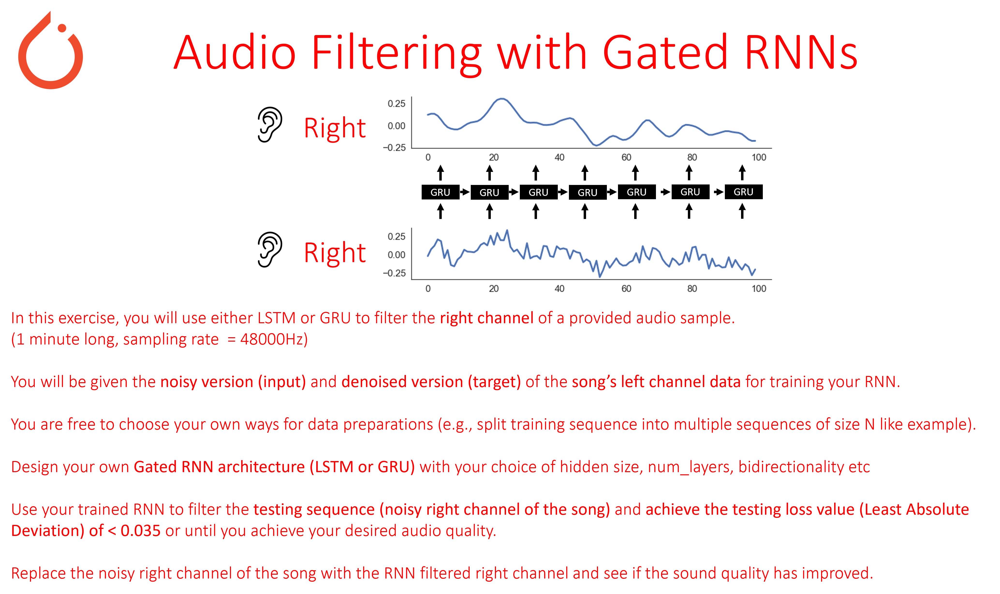

In [116]:
Image('lab6_exercise.png', width = 1000)

In [117]:
sns.set(style = 'white', font_scale = 1.5)

## Prepare Data

In [118]:
# Listen to audio with noisy right channel
# Our goal is to use RNN to denoise the right channel
# USE HEADPHONES OR SET YOUR LAPTOP VOLUME TO LOW IF YOU ARE LISTENING IN THE CLASS

import IPython
IPython.display.Audio("TSR_noisy.wav")

In [119]:
train_input_seqs = np.load('audio_train_inputs.npy') # Noisy left channel audio (training inputs to your RNN)
train_output_seqs = np.load('audio_train_targets.npy') # Ground truth left channel audio (trining targets for your RNN)

test_input_seqs = np.load('audio_test_inputs.npy')
test_output_seqs = np.load('audio_test_targets.npy')
# Print the length of training features and targets
print(len(train_input_seqs), len(train_output_seqs))

2754000 2754000


In [120]:
# Reshape train_input_seqs and output_seqs again to conform to PyTorch (sample size (N), sequence length, # of features)
train_input_seqs = train_input_seqs.reshape(6885,-1,1)
train_output_seqs = train_output_seqs.reshape(6885,-1,1)

test_input_seqs = test_input_seqs.reshape(6885,-1,1)
test_output_seqs = test_output_seqs.reshape(6885,-1,1)


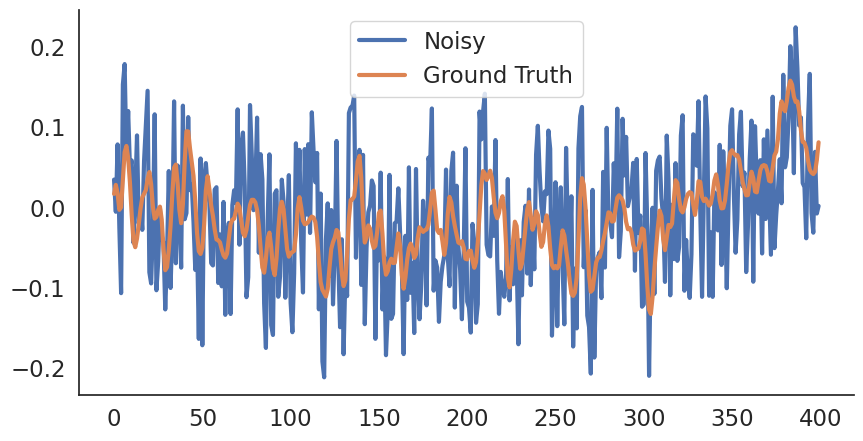

In [121]:
# let's plot one of the training input sequence/output target (10th sample)
# Feel free to plot a different sample

plt.figure(figsize = (10, 5))

plt.plot(train_input_seqs[20], label ='Noisy', linewidth = 3)
plt.plot(train_output_seqs[20], label ='Ground Truth', linewidth = 3)
plt.legend()
sns.despine()

## Define Model

In [122]:
class Denoiser_RNN(torch.nn.Module):
    
    def __init__(self, input_size, hidden_size, num_layers, output_size):
        
        super(Denoiser_RNN, self).__init__()
        
        self.gru = torch.nn.GRU(input_size=input_size, hidden_size=hidden_size, 
                                num_layers = num_layers, 
                                batch_first = True,
                                bidirectional = True)
        # Decoder layer to take in GRU hidden states and output a single number (i.e. denoised value at time t)
        self.decoder = torch.nn.Linear(2*hidden_size, output_size)
        self.output_activation = torch.nn.Tanh()
    def forward(self, input_seq, hidden_state):
        
        pred, hidden = self.gru(input_seq, hidden_state)
        pred = self.output_activation(self.decoder(pred))
        
        return pred

## Define Hyperparameters

In [123]:
# Check if GPU is available
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
# Define your model
denoiser_GRU = Denoiser_RNN(input_size = 1, hidden_size = 300, 
                            num_layers = 3, output_size = 1)
# Define lr and epochs
learning_rate = 0.005
epochs = 15

# Define mini-batch size
batchsize = 100

# Use L1Loss to minimize least absolute deviation + optimizer
loss_func = torch.nn.L1Loss()
optimizer = torch.optim.Adam(denoiser_GRU.parameters(), lr=learning_rate)
# Print out model specifics, add .cuda() if using GPU
denoiser_GRU.to(device)

Denoiser_RNN(
  (gru): GRU(1, 300, num_layers=3, batch_first=True, bidirectional=True)
  (decoder): Linear(in_features=600, out_features=1, bias=True)
  (output_activation): Tanh()
)

## Identify Tracked Values

In [124]:
# Empty list to keep track of training loss

train_loss_list = []

## Train Model

In [125]:
# Convert your training data into torch tensors

train_input_seqs = torch.from_numpy(train_input_seqs).float().to(device)
train_output_seqs = torch.from_numpy(train_output_seqs).float().to(device)

test_input_seqs = torch.from_numpy(test_input_seqs).float().to(device)
test_output_seqs = torch.from_numpy(test_output_seqs).float().to(device)

# Split your training data into mini-batches

train_batches_features = torch.split(train_input_seqs, batchsize)
train_batches_targets = torch.split(train_output_seqs, batchsize)


# Total number of mini-batches in the training set
batch_split_num = len(train_batches_features)
print(batch_split_num)
for epoch in range(epochs):
    
    for k in range(batch_split_num):
        # initialize the hidden states as None
        hidden_state = None
        
        # Feed in k-th mini-batch training features to GRU + hidden states to produce output
        pred = denoiser_GRU(train_batches_features[k], hidden_state)
        
        # zero_grad() to clear gradient buffer
        optimizer.zero_grad()
        
        # Compute loss between the GRU denoised sequence vs target training sequence
        loss = loss_func(pred, train_batches_targets[k])
        # Append loss
        train_loss_list.append(loss.item())
        
        # Backpropagation
        loss.backward()
        
        # Update weights/biases
        optimizer.step()
    
        

    print("Averaged Training Loss for Epoch ", epoch,": ", np.mean(train_loss_list[-batch_split_num:]))

69
Averaged Training Loss for Epoch  0 :  0.11080005511209584
Averaged Training Loss for Epoch  1 :  0.035077286965173225
Averaged Training Loss for Epoch  2 :  0.034984413453418274
Averaged Training Loss for Epoch  3 :  0.03358344695922257
Averaged Training Loss for Epoch  4 :  0.032962779366019844
Averaged Training Loss for Epoch  5 :  0.032436904645916344
Averaged Training Loss for Epoch  6 :  0.03103751980740091
Averaged Training Loss for Epoch  7 :  0.02868339997054874
Averaged Training Loss for Epoch  8 :  0.027419560602393703
Averaged Training Loss for Epoch  9 :  0.027736462004806683
Averaged Training Loss for Epoch  10 :  0.026921533426080925
Averaged Training Loss for Epoch  11 :  0.027065212149982868
Averaged Training Loss for Epoch  12 :  0.027974741533398628
Averaged Training Loss for Epoch  13 :  0.028264684548628502
Averaged Training Loss for Epoch  14 :  0.02765256641567617


## Visualize & Evaluate Model

### Visualizing Training Loss

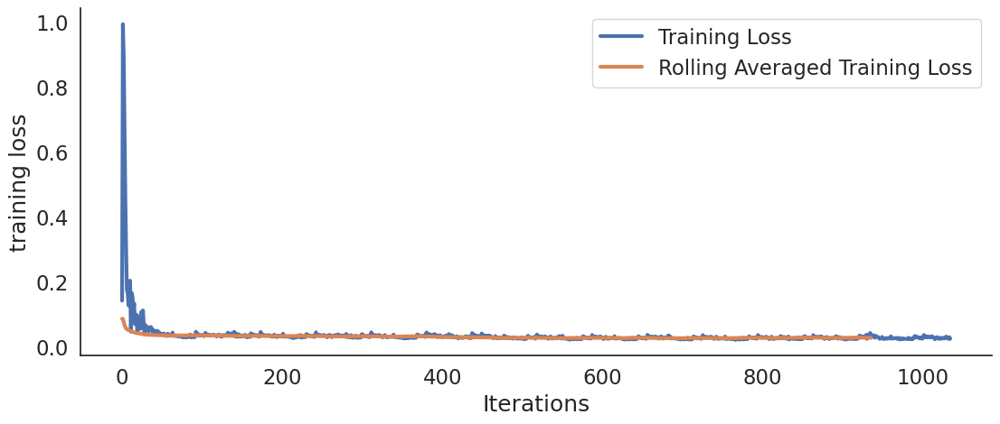

In [126]:
# Plot your training loss throughout the training 

plt.figure(figsize = (13, 5))

plt.plot(train_loss_list, linewidth = 3, label = 'Training Loss')
plt.plot(np.convolve(train_loss_list, np.ones(100), 'valid') / 100, 
         linewidth = 3, label = 'Rolling Averaged Training Loss')

plt.ylabel("training loss")
plt.xlabel("Iterations")
plt.legend()
sns.despine()

### Computing Testing Loss

In [127]:
# Each noisy test input sequence is fed into your trained RNN to produce denoised outputs
# We need to take mini-batch approach since our test_features is too big to feed it all in once (i.e. not enough memory)

# Split the test_features and targets to mini-batches
test_batches_features = torch.split(test_input_seqs, batchsize)
test_batches_targets = torch.split(test_output_seqs, batchsize)

batch_split_num_test = len(test_batches_features)

# Empty lists to keep track of RNN denoised test sequences and test losses
test_prediction = []
test_losses = []

# Turn on no_grad() since we aren't performing backprop during this process
with torch.no_grad():
    
    for k in range(batch_split_num_test):
        
        # Feed in k-th test mini-batch to trained RNN
        test_pred = denoiser_GRU(test_batches_features[k], None)
        # Compre the test_pred with test target sequence to compute testing loss
        test_loss = loss_func(test_pred, test_batches_targets[k])
        
        # Use torch.squeeze() to make test_pred to shape (batchsize, seq_len) and convert it to numpy array
        test_pred_numpy = torch.squeeze(test_pred).cpu().numpy()
        
        # Append both test_pred_numpy and test_loss 
        test_prediction.append(test_pred_numpy)
        test_losses.append(test_loss.item())
        
# Final testing loss is the average of all the test_losses from mini-batches        
print("Testing Loss (Least Absolute Deviations): ", np.mean(test_losses))

Testing Loss (Least Absolute Deviations):  0.03167965222635995


### Creating a new audio with denoised right channel sequence

In [128]:
# test_prediction is a list of 2D arrays where each array has shape (batchsize, seq_len)
# Vertically stack all appended 2D arrays so that we have a single 2D array
test_prediction = np.vstack(test_prediction)

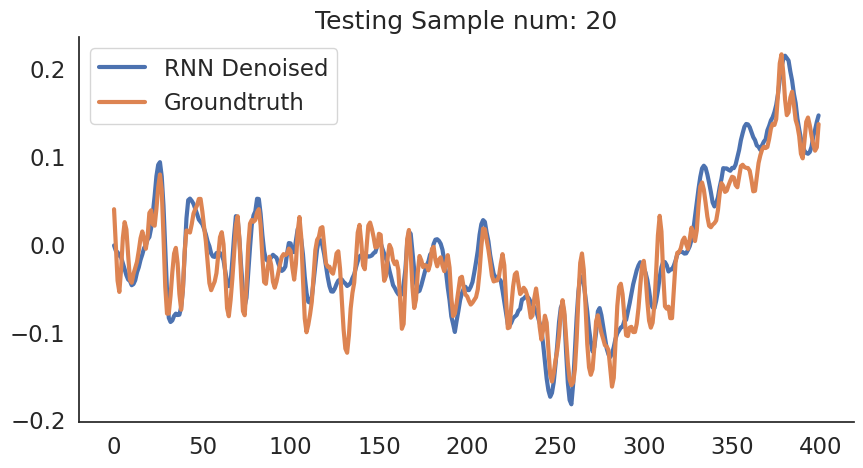

In [129]:
# We can visualize RNN denoised test sequence vs ground truth test sequence for particular sample
test_sample_num = 20
    
plt.figure(figsize = (10, 5))

plt.plot(test_prediction[test_sample_num], label='RNN Denoised', linewidth = 3)
plt.plot(test_output_seqs.cpu()[test_sample_num], label='Groundtruth', linewidth = 3)
plt.legend()
plt.title("Testing Sample num: {}".format(test_sample_num))
sns.despine()

In [130]:
# Reshape the test_prediction to 1D array of size 2754000 so that we can use it as the right channel of the song
test_prediction=test_prediction.reshape(-1)
print(test_prediction.shape)
# Reshape the train_output_seqs (ground truth left channel of the song) to 1D array as well
train_output_seqs = train_output_seqs.cpu().numpy().reshape(-1)
print(train_output_seqs.shape)
# Construct an array 'fixed_audio' of size (2754000, 2) 
# where the first column (left channel) is 1D reshaped train_output_seqs (groundtruth left channel)
# And second column (right channel) is the 1D reshaped test_prediction (RNN denoised)

fixed_audio = np.column_stack((train_output_seqs, test_prediction))
print(fixed_audio.shape)

(2754000,)
(2754000,)
(2754000, 2)


In [131]:
# Scale the fixed_audio so that it's in int16 form and write it into a new audio file

scaled = np.int16(fixed_audio/np.max(np.abs(fixed_audio)) * 32767)
write('TSR_fixed.wav', 48000, scaled)

In [112]:
# Listen to the new audio with denoised right channel
# USE HEADPHONES OR SET YOUR LAPTOP VOLUME TO LOW IF YOU ARE LISTENING IN THE CLASS

IPython.display.Audio("TSR_fixed.wav")

In [113]:
# Compare your denoised audio with ground truth audio for reference
# USE HEADPHONES OR SET YOUR LAPTOP VOLUME TO LOW IF YOU ARE LISTENING IN THE CLASS

IPython.display.Audio("TSR.wav")